In [1]:
import os
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import seaborn as sns
import numpy as np
import pandas as pd
import pickle
from tqdm import tqdm

In [2]:
pd.options.display.max_columns = 500

In [3]:
geir_path = "/geir_data/scr/petershi" #should save work here 
sdssv_path = "/yngve_data/sdssv/ipl-2/spectro/astra/0.3.0/v6_0_9-1.0/spectra/star" #path for SDSSV spectra
sdssiv_path = "/yngve_data/sdss/apogee/dr17/apogee/spectro/redux/dr17/stars/apo25m"

xmatch_path = "/yngve_data/sdssv/ipl-2/spectro/astra/0.3.0/v6_0_9-1.0/aux_xmatch/ipl-1_dr17_lite_230517_byYS.fits"
model_path = "/geir_data/scr/petershi/models/astroNN_APOGEE_VAC/astroNN_0512_run002"

In [4]:
d = open("/geir_data/scr/petershi/serialized/spec_arr.pkl", "rb")
s = open("/geir_data/scr/petershi/serialized/star_info.pkl", "rb")

stars = pickle.load(s)

diffs = pickle.load(d)

In [5]:
diffs

({'Blue': [{'2M02175107-0421222': array([1.02442059, 1.02031516, 1.02137862, ..., 0.987804  , 0.9892041 ,
           0.98940918]),
    661695886: array([1.0086882, 1.0105046, 1.0134541, ..., 1.       , 1.       ,
           1.0037935], dtype=float32),
    'Lambda': array([152.21067174, 152.42000872, 152.62934858, ..., 798.86907082,
           799.08734177, 799.30561573])},
   {'2M02181589-0405513': array([1.03317148, 1.03000325, 1.02813912, ..., 0.97858017, 0.98795263,
           0.99030353]),
    661696500: array([1.0213634, 1.0211272, 1.0209116, ..., 1.       , 1.       ,
           1.       ], dtype=float32),
    'Lambda': array([152.21067174, 152.42000872, 152.62934858, ..., 798.86907082,
           799.08734177, 799.30561573])},
   {'2M02184871-0548470': array([1.03123841, 1.02614476, 1.02556098, ..., 0.98623455, 0.9811606 ,
           0.97584801]),
    661723825: array([1.       , 1.       , 1.       , ..., 1.0037913, 1.003962 ,
           1.0018977], dtype=float32),
    'Lambda'

In [6]:
stars

{'SDSS-IV': {'2M02175107-0421222': {'SNR': 984.6037352881152,
   'RA': 34.46283,
   'DEC': -4.356174,
   'FLUX': array([[nan, nan, nan, ..., nan, nan, nan],
          [nan, nan, nan, ..., nan, nan, nan],
          [ 0.,  0.,  0., ...,  0.,  0.,  0.],
          [ 0.,  0.,  0., ...,  0.,  0.,  0.],
          [ 0.,  0.,  0., ...,  0.,  0.,  0.]]),
   'FLUX_ERR': array([[nan, nan, nan, ..., nan, nan, nan],
          [nan, nan, nan, ..., nan, nan, nan],
          [ 0.,  0.,  0., ...,  0.,  0.,  0.],
          [ 0.,  0.,  0., ...,  0.,  0.,  0.],
          [ 0.,  0.,  0., ...,  0.,  0.,  0.]]),
   'BITMASK': array([[0, 0, 0, ..., 0, 0, 0],
          [0, 0, 0, ..., 0, 0, 0],
          [0, 0, 0, ..., 0, 0, 0],
          [0, 0, 0, ..., 0, 0, 0],
          [0, 0, 0, ..., 0, 0, 0]])},
  '2M02181589-0405513': {'SNR': 1030.757506995291,
   'RA': 34.56624,
   'DEC': -4.097604,
   'FLUX': array([[nan, nan, nan, ..., nan, nan, nan],
          [nan, nan, nan, ..., nan, nan, nan],
          [ 0.,  0.,  

In [7]:
valid_apo = [list(i.keys())[0] for i in diffs[0]["Blue"]]
valid_apo

['2M02175107-0421222',
 '2M02181589-0405513',
 '2M02184871-0548470',
 '2M02184871-0548470',
 '2M02212780-0447322',
 '2M02223989-0532510',
 '2M02203142-0611130',
 '2M02203142-0611130',
 '2M02215936-0430385',
 '2M21303125+4435142',
 '2M21304058+4438335',
 '2M21333470+4532034',
 '2M21344235+4535514',
 '2M21253218+4513078',
 '2M21273481+4519004',
 '2M21270005+4517529',
 '2M21220829+4533508',
 '2M21273482+4557570',
 '2M21265892+4609131',
 '2M21321427+4555318',
 '2M21283396+4611358',
 '2M21311455+4620002',
 '2M21302993+4632089',
 '2M20270421+3858012',
 '2M20245716+3911071',
 '2M20265893+3910235',
 '2M20312634+3956196',
 '2M20312634+3956196',
 '2M20312805+4003405',
 '2M20292357+4005564',
 '2M20250670+3928220',
 '2M20224362+3947275',
 '2M20220878+3958160',
 '2M20220878+3958160',
 '2M20215160+3959496',
 '2M20215160+3959496',
 '2M20233539+3956383',
 '2M20233539+3956383',
 '2M20243892+4002353',
 '2M20335710+4006240',
 '2M20330763+4017441',
 '2M20315166+4021285',
 '2M20320941+4022514',
 '2M2033453

In [8]:
valid_cat = [list(i.keys())[1] for i in diffs[0]["Blue"]]

In [9]:
len(valid_apo)

26714

In [10]:
e = open("/geir_data/scr/petershi/serialized/SDSS-IV elementals.pkl", "rb")
#s = open("/geir_data/scr/petershi/serialized/spec_arr.pkl", "rb")

elems = pickle.load(e)
elems

{'2M02222833-0609582': {'Points': {'teff': 6174.623,
   'logg': 3.8659608,
   'Fe': 0.12513,
   'C': 0.11715299,
   'CI': 0.119972095,
   'N': 0.110195994,
   'O': 0.13452357,
   'Na': 0.0812335,
   'Mg': 0.04775849,
   'Al': 0.286916,
   'Si': 0.24246599,
   'P': nan,
   'S': 0.121136494,
   'K': 0.1320709,
   'Ca': 0.06314069,
   'Ti': -0.26493102,
   'TiII': -0.53117806,
   'V': 0.08817055,
   'Cr': -0.15326391,
   'Mn': 0.17358251,
   'Co': 0.677514,
   'Ni': 0.092515,
   'Cu': nan,
   'Ge': nan,
   'Rb': nan,
   'Ce': 0.1287231,
   'Nd': nan,
   'Yb': nan,
   'C13': nan},
  'Errors': {'teff': 34.447742,
   'logg': 0.019264188,
   'Fe': 0.00440508,
   'C': 0.040723193,
   'CI': 0.029286405,
   'N': 0.1146894,
   'O': 0.093840756,
   'Na': 0.12923124,
   'Mg': 0.010720406,
   'Al': 0.012161969,
   'Si': 0.0115177585,
   'P': 0.109039776,
   'S': 0.036926992,
   'K': 0.03782505,
   'Ca': 0.010063248,
   'Ti': 0.078032084,
   'TiII': 0.38422897,
   'V': 0.13296723,
   'Cr': 0.05510973

In [11]:
p = []
e = []

iv_snr = []
v_snr = []

for a, c in zip(valid_apo, valid_cat):
    info = elems[a]
    p.append(info["Points"])
    e.append(info["Errors"])

    ivs = stars["SDSS-IV"][a]["SNR"]
    vs = stars["SDSS-V"][c]["SNR"][0][0]

    iv_snr.append(ivs)
    v_snr.append(vs)

In [12]:
np.corrcoef(iv_snr, v_snr)

array([[1.        , 0.50969653],
       [0.50969653, 1.        ]])

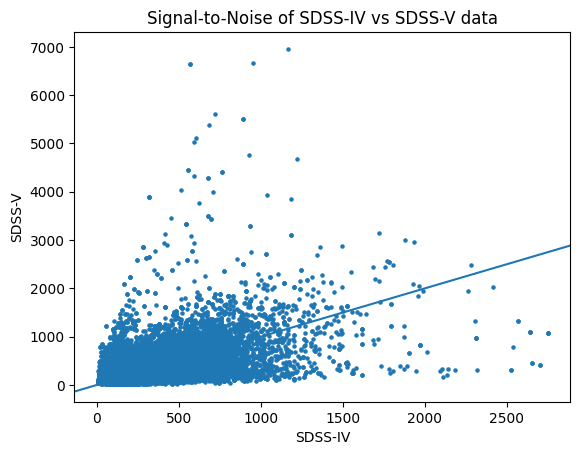

In [13]:
plt.scatter(iv_snr, v_snr, s = 5)
plt.title("Signal-to-Noise of SDSS-IV vs SDSS-V data")
plt.xlabel("SDSS-IV")
plt.ylabel("SDSS-V")
plt.axline((0, 0), slope=1)
plt.show()

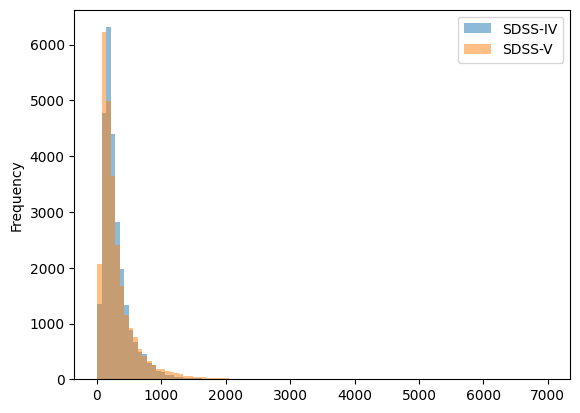

In [14]:
bins = np.linspace(0, 7000, 100)
plt.hist(iv_snr, bins = bins, label = "SDSS-IV", alpha = 0.5)
plt.hist(v_snr, bins = bins, label = "SDSS-V", alpha = 0.5)
plt.ylabel("Frequency")
plt.legend()
plt.show()

In [15]:
points = pd.DataFrame(p)
errors = pd.DataFrame(e)

In [16]:
points

,teff,logg,Fe,C,CI,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,TiII,V,Cr,Mn,Co,Ni,Cu,Ge,Rb,Ce,Nd,Yb,C13
0,6276.733398,4.114545,-0.14979,-0.132203,-0.116684,-0.041340,-0.069146,-1.080736,-0.181841,-0.018789,-0.059931,NaN,-0.139156,-0.099577,-0.139741,-0.034361,-0.723598,-0.190449,-0.458212,-0.225917,0.146126,-0.205100,NaN,NaN,NaN,0.129093,NaN,NaN,NaN
1,NaN,NaN,-0.51320,-0.645440,-0.694470,0.361360,-0.649547,0.025184,-1.079331,-0.770194,-0.776787,NaN,-0.453367,-0.364747,-0.602854,-1.326641,-1.189578,-0.413099,0.217428,-0.407647,-0.874846,-0.561930,NaN,NaN,NaN,0.290883,NaN,NaN,NaN
2,6120.736328,4.185034,-0.16747,-0.172771,-0.163914,0.054030,-0.061550,-0.512796,-0.174320,-0.087874,-0.077950,NaN,-0.185398,-0.316047,-0.175121,-0.490611,-0.447808,-0.274349,-0.165603,-0.177157,0.532814,-0.153630,NaN,NaN,NaN,-0.462517,NaN,NaN,NaN
3,6120.736328,4.185034,-0.16747,-0.172771,-0.163914,0.054030,-0.061550,-0.512796,-0.174320,-0.087874,-0.077950,NaN,-0.185398,-0.316047,-0.175121,-0.490611,-0.447808,-0.274349,-0.165603,-0.177157,0.532814,-0.153630,NaN,NaN,NaN,-0.462517,NaN,NaN,NaN
4,6785.443359,3.994033,-0.74362,-0.700940,-0.783729,-0.707768,-0.838583,-2.420537,-1.154732,-1.278574,-0.799345,NaN,-0.552217,-2.376777,-0.088574,-0.896029,-0.968398,-1.367169,-0.380142,-0.356357,0.828894,-0.914560,NaN,NaN,NaN,-1.834407,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26709,18237.105469,4.386278,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26710,17569.156250,3.723001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26711,4837.166504,2.480554,-0.19687,-0.294440,-0.297500,0.029860,-0.069686,-0.255348,-0.085870,-0.066458,-0.144886,NaN,-0.037848,-0.043801,-0.166667,-0.178145,-0.047011,-0.097588,-0.228896,-0.222788,-0.106050,-0.173827,NaN,NaN,NaN,-0.172170,NaN,NaN,NaN
26712,10211.349609,3.853112,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
errors

,teff,logg,Fe,C,CI,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,TiII,V,Cr,Mn,Co,Ni,Cu,Ge,Rb,Ce,Nd,Yb,C13
0,43.893612,0.024850,0.005641,0.060814,0.037035,0.261368,0.139877,0.209176,0.012404,0.013347,0.013212,0.146991,0.044982,0.047384,0.013203,0.106395,0.469233,0.184860,0.081446,0.013484,0.286556,0.011671,0.094630,1.0,1.0,0.261065,0.113734,1.0,0.269334
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,39.149849,0.024590,0.005881,0.053179,0.036028,0.102301,0.110897,0.191815,0.012523,0.013713,0.013163,0.132970,0.045835,0.044442,0.013170,0.093660,0.403987,0.162656,0.075852,0.013965,0.269761,0.011959,0.094245,1.0,1.0,0.227672,0.105855,1.0,0.237781
3,39.149849,0.024590,0.005881,0.053179,0.036028,0.102301,0.110897,0.191815,0.012523,0.013713,0.013163,0.132970,0.045835,0.044442,0.013170,0.093660,0.403987,0.162656,0.075852,0.013965,0.269761,0.011959,0.094245,1.0,1.0,0.227672,0.105855,1.0,0.237781
4,95.535721,0.046800,0.011568,0.202383,0.071076,4.453027,0.542881,0.774812,0.030285,0.015969,0.026820,0.358005,0.072811,0.090968,0.032066,0.279637,0.978225,0.508186,0.235930,0.031966,0.473012,0.022412,0.431691,1.0,1.0,0.802044,0.296914,1.0,0.528602
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26709,220.483566,0.046780,0.128759,0.408697,0.076166,0.044268,1.962248,1.151888,0.014630,0.075935,0.017405,0.603791,0.059496,0.125993,0.024168,0.553069,2.269055,1.003058,0.327136,0.023618,0.650416,0.020630,0.378976,1.0,1.0,1.652843,0.417743,1.0,1.057919
26710,303.751190,0.092628,0.302695,0.951028,0.164085,0.101313,4.921238,3.016194,0.025852,0.156502,0.035145,1.447638,0.126260,0.254144,0.061470,1.139216,3.777327,2.650120,0.854688,0.296346,1.098752,0.163527,1.042774,1.0,1.0,4.593436,1.121574,1.0,1.595920
26711,8.806530,0.023532,0.007292,0.013681,0.024008,0.016768,0.018463,0.063930,0.011379,0.018727,0.013517,0.134938,0.035230,0.036584,0.013759,0.020661,0.079878,0.080754,0.038999,0.014546,0.055554,0.011654,0.003924,1.0,1.0,0.070390,0.086560,1.0,0.069939
26712,221.141388,0.063028,0.046562,0.607819,0.099038,0.067609,2.737322,1.941870,0.017064,0.033032,0.019937,0.810872,0.076160,0.227649,0.033434,0.740187,2.625174,1.373768,0.499417,0.235794,0.763477,0.045526,0.798686,1.0,1.0,2.360987,0.605161,1.0,1.232288


In [18]:
cpoint = pd.read_csv(os.path.join(geir_path, "serialized", "SDSS-V point predictions.csv"))
cerr = pd.read_csv(os.path.join(geir_path, "serialized", "SDSS-V errors.csv"))

apoint = pd.read_csv(os.path.join(geir_path, "serialized", "SDSS-IV point predictions.csv"))
aerr = pd.read_csv(os.path.join(geir_path, "serialized", "SDSS-IV errors.csv"))


In [19]:
c = pd.concat(
    [cpoint, 
     cerr.rename(mapper = (lambda x : x + "_err"), axis = 1)
    ], axis = 1)

c["SNR"] = v_snr

a = pd.concat(
    [apoint, 
    aerr.rename(mapper = (lambda x : x + "_err"), axis = 1)
    ], axis = 1)

a["SNR"] = iv_snr

r = pd.concat(
    [points, 
    errors.rename(mapper = (lambda x : x + "_err"), axis = 1)
    ], axis = 1)

In [22]:
mask = (c["logg_err"] < 0.2) | (a["logg_err"] < 0.2)

In [23]:
a["Mg/Fe"] = a["Mg"] - a["Fe"]
c["Mg/Fe"] = c["Mg"] - c["Fe"]
r["Mg/Fe"] = r["Mg"] - r["Fe"]

In [24]:
comb = pd.concat(
                [a.rename(mapper = (lambda x : x + "_IV"), axis = 1), 
                 c.rename(mapper = (lambda x : x + "_V"), axis = 1)
                ], axis = 1)


In [25]:
comb

,teff_IV,logg_IV,C_IV,C1_IV,N_IV,O_IV,Na_IV,Mg_IV,Al_IV,Si_IV,P_IV,S_IV,K_IV,Ca_IV,Ti_IV,Ti2_IV,V_IV,Cr_IV,Mn_IV,Fe_IV,Co_IV,Ni_IV,teff_err_IV,logg_err_IV,C_err_IV,C1_err_IV,N_err_IV,O_err_IV,Na_err_IV,Mg_err_IV,Al_err_IV,Si_err_IV,P_err_IV,S_err_IV,K_err_IV,Ca_err_IV,Ti_err_IV,Ti2_err_IV,V_err_IV,Cr_err_IV,Mn_err_IV,Fe_err_IV,Co_err_IV,Ni_err_IV,SNR_IV,Mg/Fe_IV,teff_V,logg_V,C_V,C1_V,N_V,O_V,Na_V,Mg_V,Al_V,Si_V,P_V,S_V,K_V,Ca_V,Ti_V,Ti2_V,V_V,Cr_V,Mn_V,Fe_V,Co_V,Ni_V,teff_err_V,logg_err_V,C_err_V,C1_err_V,N_err_V,O_err_V,Na_err_V,Mg_err_V,Al_err_V,Si_err_V,P_err_V,S_err_V,K_err_V,Ca_err_V,Ti_err_V,Ti2_err_V,V_err_V,Cr_err_V,Mn_err_V,Fe_err_V,Co_err_V,Ni_err_V,SNR_V,Mg/Fe_V
0,6208.5605,4.101528,-0.135709,-0.141518,0.158099,-0.043693,-0.305813,-0.166474,-0.093243,-0.049173,-0.114158,-0.162395,-0.136830,-0.168891,-0.270613,-0.217719,-0.187132,-0.415220,-0.209886,-0.149736,-0.360965,-0.171871,147.403214,0.144841,0.030752,0.065775,0.242884,0.057392,0.551930,0.051502,0.106655,0.055749,1.213758,0.070522,0.121809,0.087466,0.252401,0.103950,0.123018,0.331139,0.104086,0.065335,0.318575,0.064713,984.603735,-0.016738,6190.0550,4.457842,-0.339803,-0.366619,-0.079650,-0.351144,-0.663121,-0.491391,-0.372453,-0.366536,-0.422017,-0.409655,-0.443052,-0.442479,-0.600350,-0.471057,-0.518086,-0.663365,-0.549224,-0.478378,-0.772037,-0.560726,211.122004,0.252104,0.060656,0.107026,0.310553,0.092855,0.717092,0.100179,0.141561,0.095078,2.972803,0.092501,0.186257,0.119437,0.322842,0.133280,0.173246,0.318213,0.136918,0.109962,0.562355,0.125013,2290.580811,-0.013012
1,6015.0166,4.319855,-0.551258,-0.467714,-0.076482,-0.338898,-0.487706,-0.451491,-0.419134,-0.344218,-0.332023,-0.466858,-0.448267,-0.426562,-0.662854,-0.278778,-0.561807,-0.480382,-0.485332,-0.446011,-0.725756,-0.453805,201.514632,0.260943,0.088367,0.095035,0.297822,0.093298,0.348667,0.099089,0.149197,0.097106,3.704951,0.104748,0.223841,0.122193,0.281180,0.109902,0.242927,0.153218,0.131527,0.111612,0.519890,0.105069,1030.757507,-0.005479,6015.6685,4.373784,-0.747856,-0.835469,-0.193097,-0.477060,-0.747643,-0.594040,-0.550558,-0.463968,-0.655355,-0.757290,-0.568231,-0.541049,-0.757432,-0.626465,-0.688465,-0.663903,-0.669886,-0.583254,-0.850598,-0.611369,263.718644,0.345986,0.137395,0.214319,0.395909,0.140880,0.662755,0.139417,0.196807,0.146675,4.270470,0.162148,0.224605,0.152638,0.329214,0.219165,0.244178,0.360588,0.175068,0.152324,0.546202,0.141541,1388.765869,-0.010786
2,6069.5650,4.153462,-0.191011,-0.173067,0.065416,-0.093690,-0.365687,-0.180288,-0.063971,-0.083202,-0.083286,-0.201715,-0.170218,-0.147403,-0.423287,-0.201551,-0.259697,-0.312905,-0.211950,-0.181895,-0.454788,-0.182765,126.400292,0.142059,0.023472,0.056495,0.189721,0.051376,0.449136,0.049895,0.088950,0.053728,1.521649,0.044004,0.139574,0.071486,0.219126,0.097710,0.153397,0.172146,0.087086,0.057146,0.421058,0.060680,507.362956,0.001607,6115.4430,4.256338,-0.482676,-0.527112,-0.315300,-0.407196,-0.558416,-0.401313,-0.735734,-0.351914,-0.525369,-0.438781,-0.474906,-0.470537,-0.742470,-0.243872,-0.562975,-0.730244,-0.633580,-0.519107,-0.753149,-0.520758,204.601854,0.240423,0.074096,0.115570,0.278319,0.096701,0.408177,0.091400,0.201703,0.102814,2.688294,0.079761,0.221031,0.121035,0.272479,0.088847,0.196147,0.371188,0.134980,0.109888,0.471220,0.106447,468.657043,0.117794
3,6088.5980,4.159681,-0.189188,-0.168666,0.045640,-0.087676,-0.345437,-0.174720,-0.062565,-0.078342,-0.091457,-0.196422,-0.154957,-0.141132,-0.412797,-0.165687,-0.256965,-0.308990,-0.210914,-0.177716,-0.445048,-0.176759,121.051417,0.134187,0.022469,0.055668,0.178036,0.048422,0.422893,0.051010,0.092705,0.050849,1.268787,0.047672,0.135902,0.071952,0.216572,0.091619,0.154970,0.175029,0.088057,0.055487,0.412200,0.057876,507.362956,0.002997,6092.0776,4.237414,-0.496264,-0.548490,-0.328005,-0.426271,-0.582902,-0.419525,-0.732506,-0.368370,-0.564117,-0.453243,-0.495062,-0.484593,-0.770747,-0.268118,-0.583632,-0.738972,-0.651499,-0.534189,-0.769153,-0.541365,212.836333,0.

In [26]:
diff = a - c 

In [27]:
comb2 = pd.concat(
                [comb, 
                 diff.rename(mapper = (lambda x : x + "_diff"), axis = 1)
                ], axis = 1)

In [28]:
comb3 = comb2[mask]

In [26]:
sns.set(rc={'figure.figsize':(100, 100)})
sns.heatmap(comb.corr(), annot = True)

<Axes: >

In [27]:
sns.set(rc={'figure.figsize':(100, 100)})
sns.heatmap(comb2.corr(), annot = True)

<Axes: >

<Axes: xlabel='teff_IV', ylabel='teff_diff'>

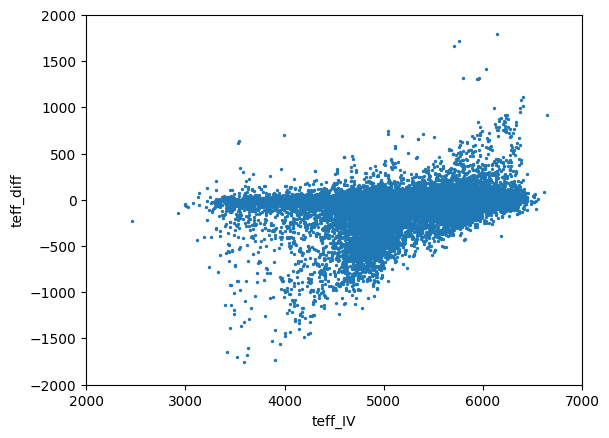

In [29]:
comb2.plot(x = "teff_IV", y = "teff_diff", kind = "scatter", ylim = [-2000, 2000], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_IV', ylabel='teff_diff'>

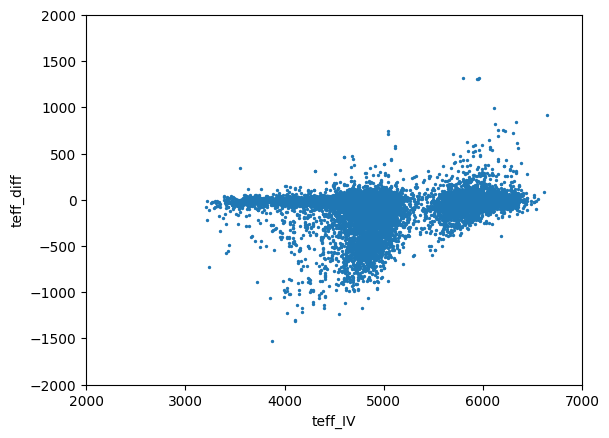

In [30]:
comb3.plot(x = "teff_IV", y = "teff_diff", kind = "scatter", ylim = [-2000, 2000], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_V', ylabel='teff_diff'>

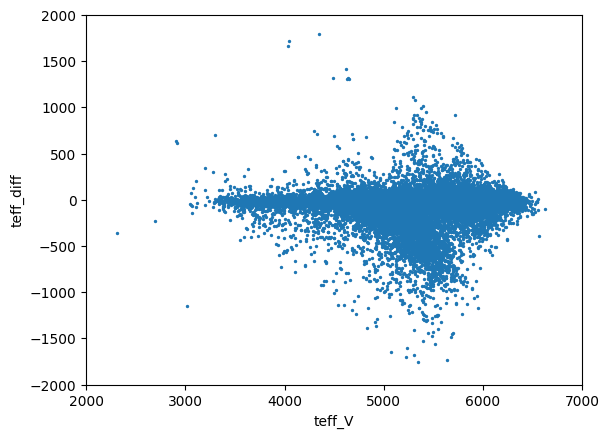

In [27]:
comb2.plot(x = "teff_V", y = "teff_diff", kind = "scatter", ylim = [-2000, 2000], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_V', ylabel='teff_diff'>

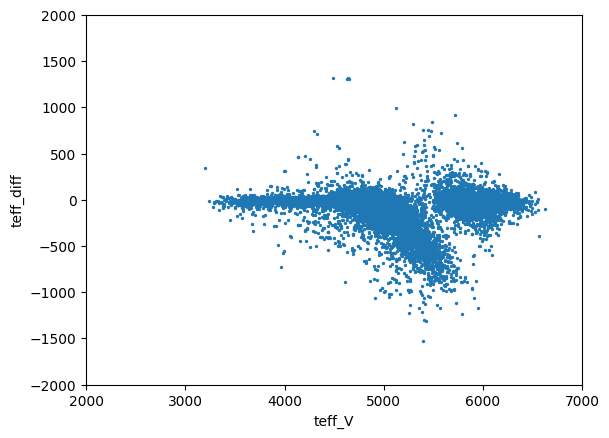

In [31]:
comb3.plot(x = "teff_V", y = "teff_diff", kind = "scatter", ylim = [-2000, 2000], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_IV', ylabel='logg_diff'>

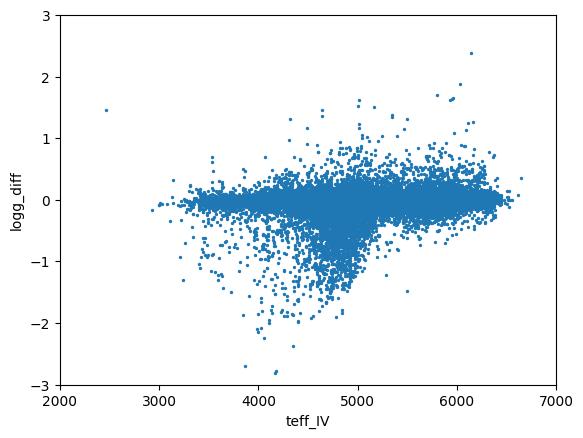

In [31]:
comb2.plot(x = "teff_IV", y = "logg_diff", kind = "scatter", ylim = [-3, 3], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_IV', ylabel='logg_diff'>

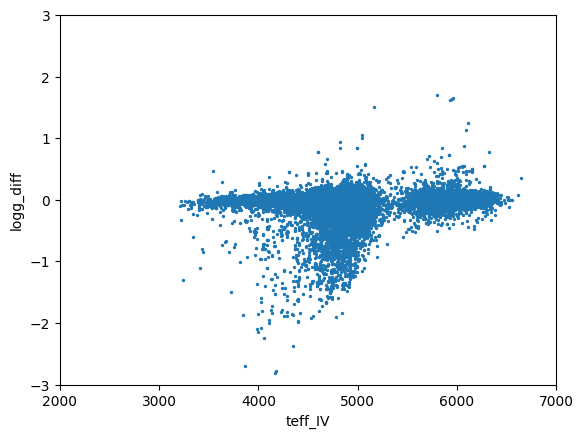

In [32]:
comb3.plot(x = "teff_IV", y = "logg_diff", kind = "scatter", ylim = [-3, 3], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_V', ylabel='logg_diff'>

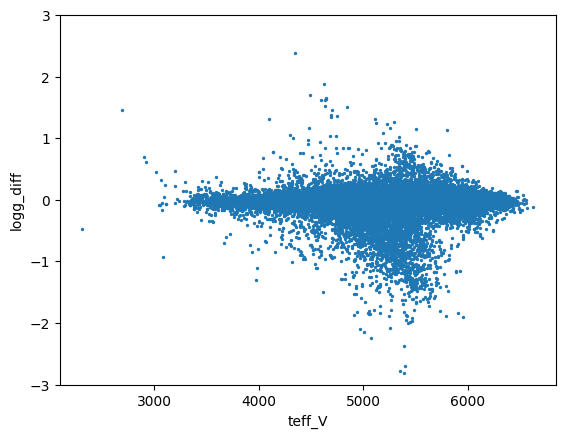

In [29]:
comb2.plot(x = "teff_V", y = "logg_diff", kind = "scatter", ylim = [-3, 3], s = 2)

<Axes: xlabel='teff_V', ylabel='logg_diff'>

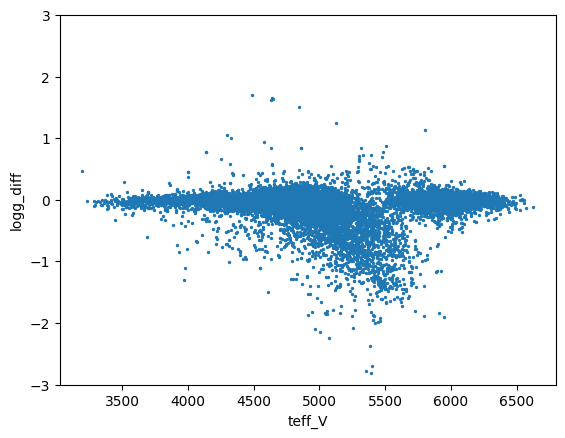

In [33]:
comb3.plot(x = "teff_V", y = "logg_diff", kind = "scatter", ylim = [-3, 3], s = 2)

<Axes: xlabel='teff_IV', ylabel='Fe_diff'>

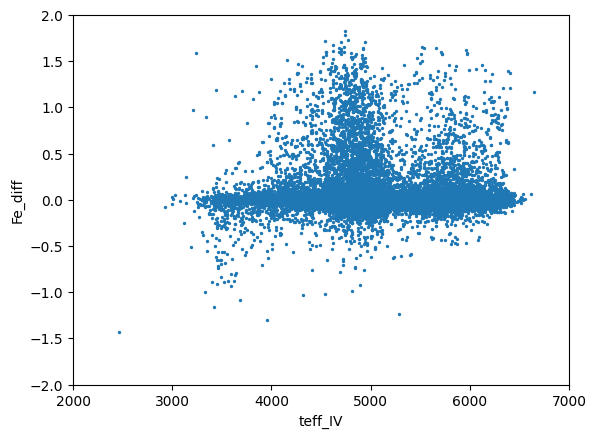

In [33]:
comb2.plot(x = "teff_IV", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_IV', ylabel='Fe_diff'>

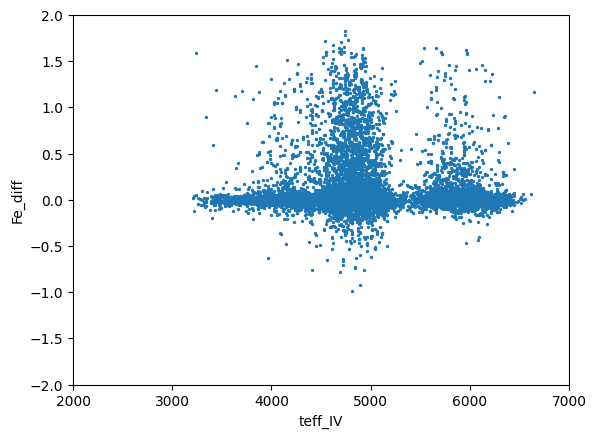

In [34]:
comb3.plot(x = "teff_IV", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], xlim = [2000, 7000], s = 2)

<Axes: xlabel='teff_V', ylabel='Fe_diff'>

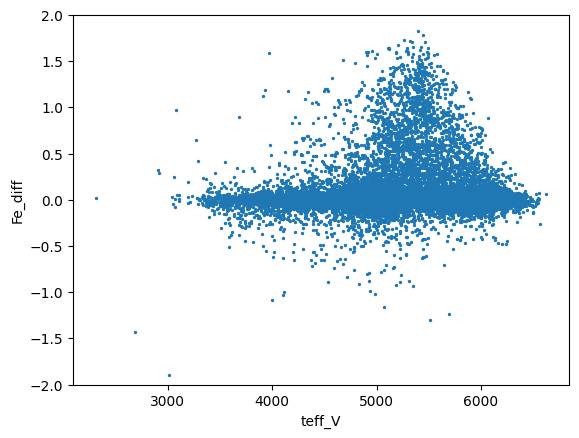

In [40]:
comb2.plot(x = "teff_V", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], s = 2)

<Axes: xlabel='teff_V', ylabel='Fe_diff'>

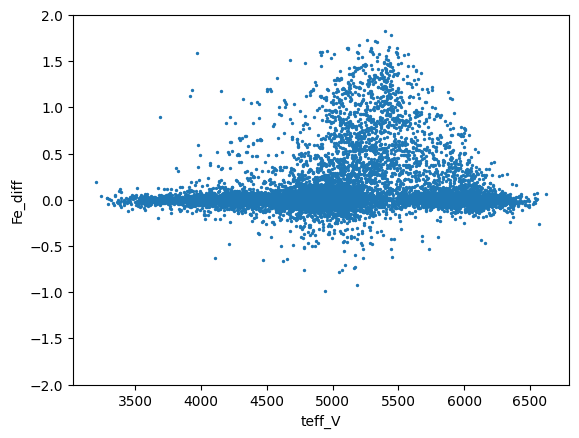

In [35]:
comb3.plot(x = "teff_V", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], s = 2)

<Axes: xlabel='Fe_IV', ylabel='Fe_diff'>

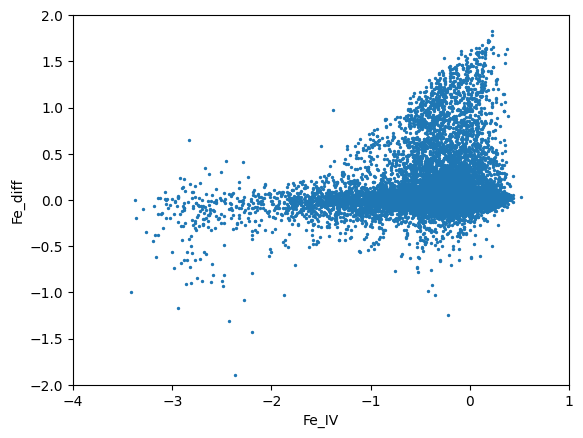

In [35]:
comb2.plot(x = "Fe_IV", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], xlim = [-4, 1], s = 2)

<Axes: xlabel='Fe_IV', ylabel='Fe_diff'>

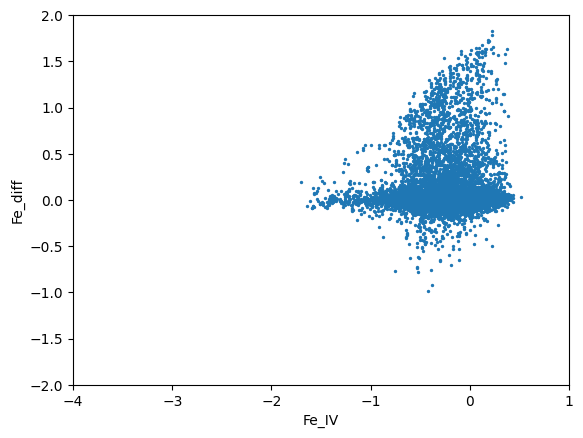

In [36]:
comb3.plot(x = "Fe_IV", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], xlim = [-4, 1], s = 2)

<Axes: xlabel='Fe_V', ylabel='Fe_diff'>

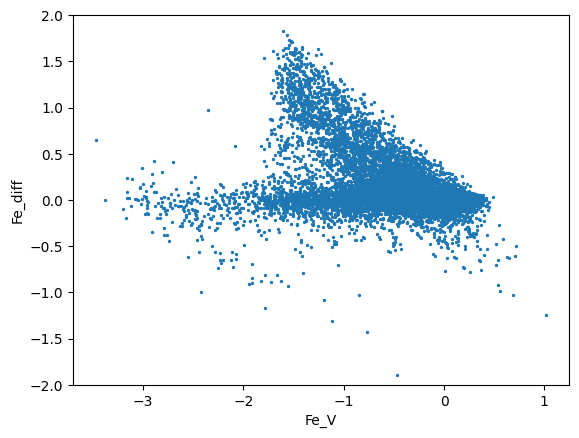

In [42]:
comb2.plot(x = "Fe_V", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], s = 2)

<Axes: xlabel='Fe_V', ylabel='Fe_diff'>

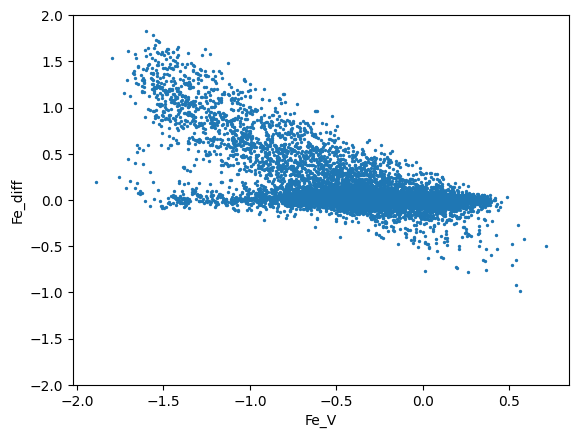

In [37]:
comb3.plot(x = "Fe_V", y = "Fe_diff", kind = "scatter", ylim = [-2, 2], s = 2)

<Axes: xlabel='logg_V', ylabel='logg_diff'>

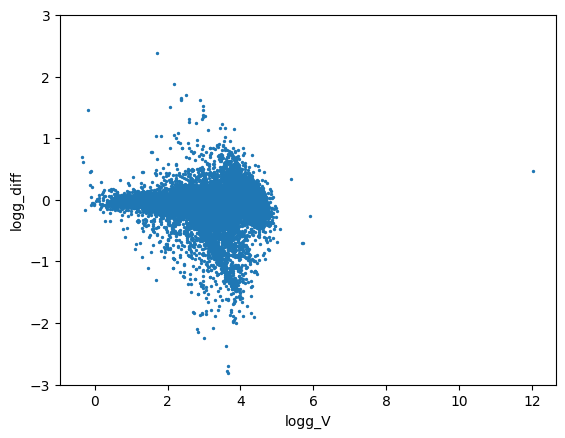

In [43]:
comb2.plot(x = "logg_V", y = "logg_diff", kind = "scatter", ylim = [-3, 3], s = 2)

<Axes: xlabel='logg_V', ylabel='logg_diff'>

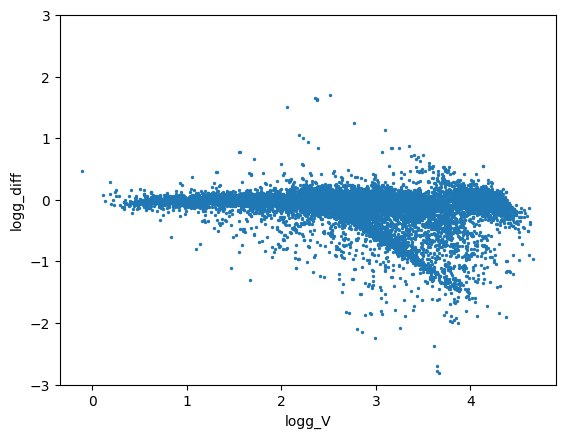

In [38]:
comb3.plot(x = "logg_V", y = "logg_diff", kind = "scatter", ylim = [-3, 3], s = 2)

<Axes: xlabel='logg_IV', ylabel='logg_diff'>

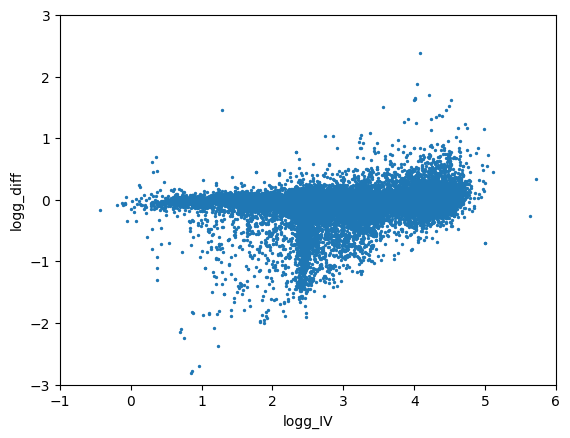

In [40]:
comb2.plot(x = "logg_IV", y = "logg_diff", kind = "scatter", ylim = [-3, 3], xlim = [-1 , 6], s = 2)

<Axes: xlabel='logg_IV', ylabel='logg_diff'>

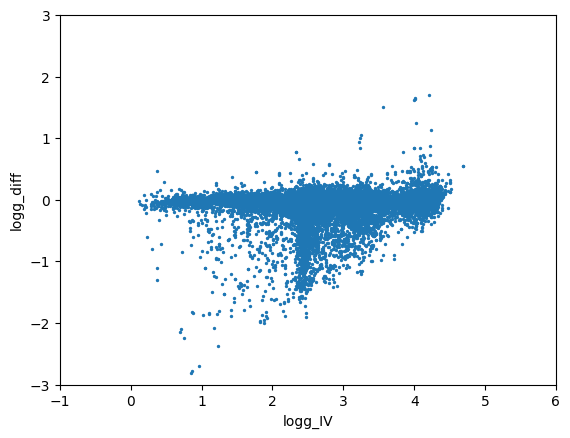

: 

In [41]:
comb3.plot(x = "logg_IV", y = "logg_diff", kind = "scatter", ylim = [-3, 3], xlim = [-1 , 6], s = 2)

<Axes: xlabel='Fe_IV', ylabel='logg_diff'>

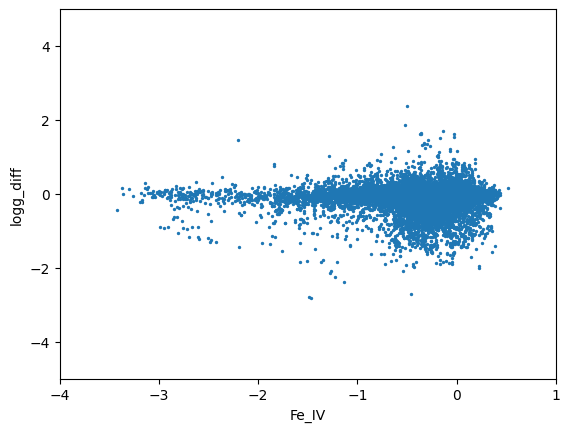

In [57]:
comb2.plot(x = "Fe_IV", y = "logg_diff", kind = "scatter", ylim = [-5, 5], xlim = [-4, 1], s = 2)

<Axes: xlabel='Fe_V', ylabel='logg_diff'>

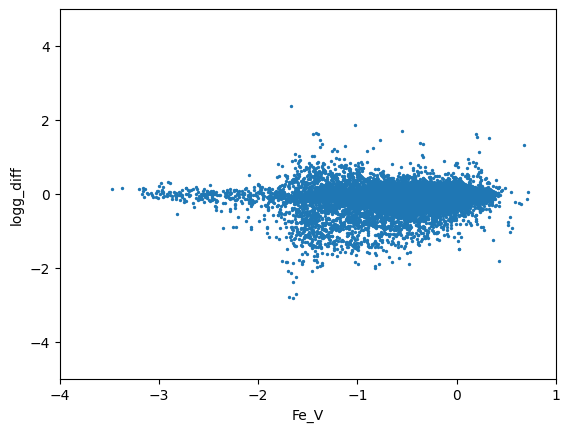

In [56]:
comb2.plot(x = "Fe_V", y = "logg_diff", kind = "scatter", ylim = [-5, 5], xlim = [-4, 1], s = 2)

In [24]:
afilt = a[a["logg_err"] < 0.2]
cfilt = c[c["logg_err"] < 0.2]
rfilt = r[r["logg_err"] < 0.2]

In [25]:
print(afilt.shape, cfilt.shape, rfilt.shape)

(19729, 46) (17119, 46) (26003, 59)


In [26]:
rfilt

,teff,logg,Fe,C,CI,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,TiII,V,Cr,Mn,Co,Ni,Cu,Ge,Rb,Ce,Nd,Yb,C13,teff_err,logg_err,Fe_err,C_err,CI_err,N_err,O_err,Na_err,Mg_err,Al_err,Si_err,P_err,S_err,K_err,Ca_err,Ti_err,TiII_err,V_err,Cr_err,Mn_err,Co_err,Ni_err,Cu_err,Ge_err,Rb_err,Ce_err,Nd_err,Yb_err,C13_err,Mg/Fe
0,6276.733398,4.114545,-0.14979,-0.132203,-0.116684,-0.041340,-0.069146,-1.080736,-0.181841,-0.018789,-0.059931,NaN,-0.139156,-0.099577,-0.139741,-0.034361,-0.723598,-0.190449,-0.458212,-0.225917,0.146126,-0.205100,NaN,NaN,NaN,0.129093,NaN,NaN,NaN,43.893612,0.024850,0.005641,0.060814,0.037035,0.261368,0.139877,0.209176,0.012404,0.013347,0.013212,0.146991,0.044982,0.047384,0.013203,0.106395,0.469233,0.184860,0.081446,0.013484,0.286556,0.011671,0.094630,1.0,1.0,0.261065,0.113734,1.0,0.269334,-0.032051
2,6120.736328,4.185034,-0.16747,-0.172771,-0.163914,0.054030,-0.061550,-0.512796,-0.174320,-0.087874,-0.077950,NaN,-0.185398,-0.316047,-0.175121,-0.490611,-0.447808,-0.274349,-0.165603,-0.177157,0.532814,-0.153630,NaN,NaN,NaN,-0.462517,NaN,NaN,NaN,39.149849,0.024590,0.005881,0.053179,0.036028,0.102301,0.110897,0.191815,0.012523,0.013713,0.013163,0.132970,0.045835,0.044442,0.013170,0.093660,0.403987,0.162656,0.075852,0.013965,0.269761,0.011959,0.094245,1.0,1.0,0.227672,0.105855,1.0,0.237781,-0.006850
3,6120.736328,4.185034,-0.16747,-0.172771,-0.163914,0.054030,-0.061550,-0.512796,-0.174320,-0.087874,-0.077950,NaN,-0.185398,-0.316047,-0.175121,-0.490611,-0.447808,-0.274349,-0.165603,-0.177157,0.532814,-0.153630,NaN,NaN,NaN,-0.462517,NaN,NaN,NaN,39.149849,0.024590,0.005881,0.053179,0.036028,0.102301,0.110897,0.191815,0.012523,0.013713,0.013163,0.132970,0.045835,0.044442,0.013170,0.093660,0.403987,0.162656,0.075852,0.013965,0.269761,0.011959,0.094245,1.0,1.0,0.227672,0.105855,1.0,0.237781,-0.006850
4,6785.443359,3.994033,-0.74362,-0.700940,-0.783729,-0.707768,-0.838583,-2.420537,-1.154732,-1.278574,-0.799345,NaN,-0.552217,-2.376777,-0.088574,-0.896029,-0.968398,-1.367169,-0.380142,-0.356357,0.828894,-0.914560,NaN,NaN,NaN,-1.834407,NaN,NaN,NaN,95.535721,0.046800,0.011568,0.202383,0.071076,4.453027,0.542881,0.774812,0.030285,0.015969,0.026820,0.358005,0.072811,0.090968,0.032066,0.279637,0.978225,0.508186,0.235930,0.031966,0.473012,0.022412,0.431691,1.0,1.0,0.802044,0.296914,1.0,0.528602,-0.411112
5,9793.469727,4.297631,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,221.141388,0.063028,0.095692,0.607819,0.099038,0.067609,2.737322,1.941870,0.017064,0.319359,0.019937,0.810872,0.076160,0.158521,0.033434,0.740187,2.625174,1.373768,0.499417,0.038104,0.763477,0.134261,0.798686,1.0,1.0,2.360987,0.605161,1.0,1.232288,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26709,18237.105469,4.386278,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,220.483566,0.046780,0.128759,0.408697,0.076166,0.044268,1.962248,1.151888,0.014630,0.075935,0.017405,0.603791,0.059496,0.125993,0.024168,0.553069,2.269055,1.003058,0.327136,0.023618,0.650416,0.020630,0.378976,1.0,1.0,1.652843,0.417743,1.0,1.057919,NaN
26710,17569.156250,3.723001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,303.751190,0.092628,0.302695,0.951028,0.164085,0.101313,4.921238,3.016194,0.025852,0.156502,0.035145,1.447638,0.126260,0.254144,0.061470,1.139216,3.777327,2.650120,0.854688,0.296346,1.098752,0.163527,1.042774,1.0,1.0,4.593436,1.121574,1.0,1.595920,NaN
26711,4837.166504,2.480554,-0.19687,-0.294440,-0.297500,0.029860,-0.069686,-0.255348,-0.085870,-0.066458,-0.144886,NaN,-0.037848,-0.043801,-0.166667,-0.178145,-0.047011,-0.097588,-0.228896,-0.222788,-0.106050,-0.173827,NaN,NaN,NaN,-0.172170,NaN,NaN,NaN,8.806530,0.023532,0.007292,0.0

# Error differences

In [27]:
pd.options.mode.use_inf_as_na = True

In [28]:
aerr.count()

teff    26714
logg    26713
C       26713
C1      26713
N       26713
O       26713
Na      26714
Mg      26713
Al      26714
Si      26714
P       26714
S       26713
K       26713
Ca      26713
Ti      26714
Ti2     26714
V       26714
Cr      26713
Mn      26713
Fe      26713
Co      26713
Ni      26713
dtype: int64

In [29]:
aerr.iloc[aerr.index[np.isinf(aerr).any(1)]]

/tmp/ipykernel_31046/2251924697.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  aerr.iloc[aerr.index[np.isinf(aerr).any(1)]]


,teff,logg,C,C1,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,Ti2,V,Cr,Mn,Fe,Co,Ni
3568,1.233121e+19,NaN,NaN,NaN,NaN,NaN,857.426893,NaN,7.463173e+16,3.857593e+07,301.07251,NaN,NaN,NaN,22.169855,28.643417,45.769264,NaN,NaN,NaN,NaN,NaN


In [30]:
aerr.idxmax()

teff     3568
logg    21970
C       17072
C1      18069
N       21970
O       14757
Na       3568
Mg      18069
Al       3568
Si       3568
P       17506
S       17072
K       21540
Ca      18873
Ti       3568
Ti2      3568
V        3568
Cr        115
Mn      21540
Fe      21970
Co       8163
Ni      18069
dtype: int64

In [31]:
aerr = aerr.fillna(9999)

In [32]:
bad_df = aerr.index.isin([3568])
aerr[~bad_df].describe()

,teff,logg,C,C1,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,Ti2,V,Cr,Mn,Fe,Co,Ni
count,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000
mean,84.597497,0.208137,0.067897,0.092923,0.109473,0.070464,0.184615,0.062843,0.086103,0.067260,38.896471,0.061130,0.365974,0.059378,0.098531,0.136583,0.139541,0.106529,0.084215,0.082450,0.391106,0.069599
std,83.127862,0.484242,0.197671,0.210819,0.182520,0.161863,0.176011,0.151734,0.131017,0.178417,787.020085,0.152137,41.476051,0.063977,0.102258,0.420150,0.269328,0.151175,0.105723,0.270447,22.771762,0.149880
min,13.373328,0.037527,0.011029,0.018568,0.009921,0.013569,0.034688,0.013628,0.016776,0.012681,0.163498,0.012670,0.029591,0.018533,0.020642,0.017651,0.029370,0.017472,0.023457,0.014096,0.012746,0.016713
25%,27.862284,0.068391,0.023052,0.032168,0.027572,0.027303,0.066141,0.025599,0.034033,0.022231,0.518583,0.021112,0.045547,0.026786,0.034748,0.041026,0.071782,0.035573,0.036129,0.023648,0.026085,0.025980
50%,46.087281,0.109585,0.032501,0.046773,0.053655,0.045297,0.106204,0.035862,0.053982,0.037232,0.740063,0.035091,0.066153,0.037578,0.047651,0.073264,0.091025,0.054418,0.055637,0.035165,0.062689,0.039511
75%,120.578654,0.207476,0.051289,0.070803,0.104866,0.061042,0.247165,0.050957,0.082835,0.059617,1.494888,0.069012,0.116340,0.062609,0.138149,0.118807,0.127102,0.116837,0.094668,0.058791,0.303569,0.064612
max,838.951315,33.016324,8.682904,4.229174,4.880843,4.309365,2.869178,4.464124,2.965169,5.523734,53677.755911,17.543983,6777.377089,1.001861,1.277665,13.458507,6.746383,7.369225,2.370688,10.910050,3688.337689,3.919252


In [33]:
cerr[~bad_df].describe()

,teff,logg,C,C1,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,Ti2,V,Cr,Mn,Fe,Co,Ni
count,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,2.671300e+04,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,2.671300e+04,26713.000000
mean,111.203762,0.246243,0.084249,0.123341,0.139986,0.089175,2.612700e+02,0.078256,0.115733,0.090450,29.677456,0.079334,0.174329,0.081110,0.125660,0.149433,0.169126,0.152276,0.104278,0.099654,1.472908e+05,0.088265
std,99.084298,0.382855,0.179606,0.205927,0.245284,0.150073,4.266131e+04,0.134933,0.134606,0.155335,604.398360,0.218604,4.563063,0.074942,0.122423,0.340828,0.257525,0.210304,0.107332,0.225635,2.014373e+07,0.139666
min,12.572666,0.038485,0.012344,0.018447,0.011323,0.014083,3.565463e-02,0.014382,0.018128,0.012995,0.083838,0.013509,0.031502,0.019627,0.020453,0.019198,0.030100,0.019066,0.023463,0.014600,1.296200e-02,0.018031
25%,35.519779,0.085256,0.029212,0.041261,0.040306,0.035624,7.756924e-02,0.030716,0.048550,0.033103,0.582819,0.026719,0.051225,0.036675,0.039110,0.050489,0.085218,0.040557,0.044101,0.028950,3.447693e-02,0.033768
50%,74.544965,0.146723,0.042561,0.061521,0.073855,0.054457,1.484028e-01,0.045374,0.072438,0.055204,0.943387,0.049635,0.080602,0.055738,0.064272,0.088034,0.111831,0.069292,0.074948,0.051503,1.330154e-01,0.056105
75%,143.447593,0.275269,0.074086,0.124180,0.143235,0.081091,3.554516e-01,0.069452,0.120151,0.087833,2.083257,0.091037,0.163881,0.087787,0.181043,0.150747,0.164138,0.187513,0.112780,0.080509,4.250000e-01,0.082645
max,785.811443,17.901945,9.805482,5.353747,20.051209,4.233379,6.972612e+06,4.084426,2.736140,4.963837,53149.164673,26.368926,734.284579,1.930226,1.573806,11.975413,6.631083,14.538536,2.094346,6.029971,3.212577e+09,4.674729


In [34]:
err_diff = aerr[~bad_df] - cerr[~bad_df]

err_diff.describe()

,teff,logg,C,C1,N,O,Na,Mg,Al,Si,P,S,K,Ca,Ti,Ti2,V,Cr,Mn,Fe,Co,Ni
count,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,2.671300e+04,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,26713.000000,2.671300e+04,26713.000000
mean,-26.606265,-0.038105,-0.016352,-0.030418,-0.030514,-0.018711,-2.610854e+02,-0.015414,-0.029630,-0.023191,9.219015,-0.018204,0.191644,-0.021732,-0.027130,-0.012850,-0.029585,-0.045747,-0.020063,-0.017204,-1.472904e+05,-0.018666
std,64.442011,0.292622,0.098965,0.108583,0.187476,0.084427,4.266131e+04,0.075364,0.080201,0.091778,488.686877,0.137583,36.993840,0.048379,0.078956,0.201618,0.146482,0.162471,0.064968,0.136863,2.014373e+07,0.078291
min,-440.769065,-2.860307,-3.615934,-3.380706,-20.032495,-2.112213,-6.972612e+06,-2.167028,-1.327354,-2.716820,-20923.301340,-12.858511,-113.647188,-1.404448,-1.510477,-3.154280,-4.174893,-7.169311,-0.905164,-2.400306,-3.212577e+09,-2.637514
25%,-20.016393,-0.033101,-0.016389,-0.034103,-0.025341,-0.017512,-1.060042e-01,-0.014178,-0.028150,-0.023590,-0.393384,-0.021155,-0.036694,-0.023103,-0.021096,-0.028155,-0.039161,-0.035512,-0.016533,-0.012693,-1.492948e-01,-0.016876
50%,-5.883853,-0.009763,-0.004912,-0.006839,-0.008556,-0.005142,-1.209093e-02,-0.003436,-0.009311,-0.007653,-0.094004,-0.005142,-0.005313,-0.008331,-0.004636,-0.005592,-0.012550,-0.004176,-0.005014,-0.003641,-5.513268e-03,-0.005502
75%,-0.620162,0.000383,0.000620,0.002314,0.000039,0.000936,1.271649e-02,0.000998,0.000574,-0.000530,0.060049,0.002588,0.008295,-0.001482,0.002292,0.008643,0.003585,0.007145,0.000717,-0.000328,1.715595e-02,-0.000157
max,620.350724,32.185653,5.937520,2.613246,4.712722,3.289522,1.381429e+00,3.451540,1.984786,4.409285,51368.063106,4.804057,6043.092510,0.498075,0.686699,7.799157,4.400037,3.817955,1.625772,10.697513,3.688142e+03,2.758379


generally the DR17 data has lower errors than the SDSS-V data 

# Teff/Log(g)

In [35]:
adrop = a.replace([np.inf, -np.inf], np.nan).dropna(subset = ["logg_err"])
np.corrcoef(adrop["logg_err"], adrop["SNR"])

array([[ 1.        , -0.08357841],
       [-0.08357841,  1.        ]])

In [36]:
cdrop = c.replace([np.inf, -np.inf], np.nan).dropna(subset = ["logg_err"])
np.corrcoef(cdrop["logg_err"], cdrop["SNR"])

array([[ 1.        , -0.03098931],
       [-0.03098931,  1.        ]])

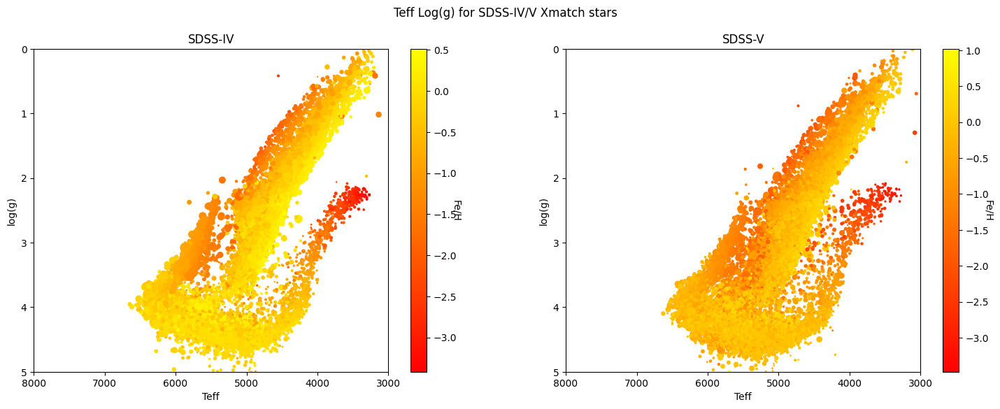

In [37]:
fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle("Teff Log(g) for SDSS-IV/V Xmatch stars")
fig.set_size_inches(18, 6)

af = a[a["teff"] > 0]

map1 = ax1.scatter(af["teff"], af["logg"], s = af["SNR"]/30, c = af["Fe"], cmap = "autumn")
ax1.set_title("SDSS-IV")
ax1.set_xlabel("Teff")
ax1.set_ylabel("log(g)")
ax1.set_xlim([8000, 3000])
ax1.set_ylim([5, 0])

map2 = ax2.scatter(c["teff"], c["logg"], s = c["SNR"]/30, c = c["Fe"], cmap = "autumn")
ax2.set_title("SDSS-V")
ax2.set_xlabel("Teff")
ax2.set_ylabel("log(g)")
ax2.set_xlim([8000, 3000])
ax2.set_ylim([5, 0])

fig.colorbar(map1).set_label("Fe/H", rotation=270)
fig.colorbar(map2).set_label("Fe/H", rotation=270)
fig.show()

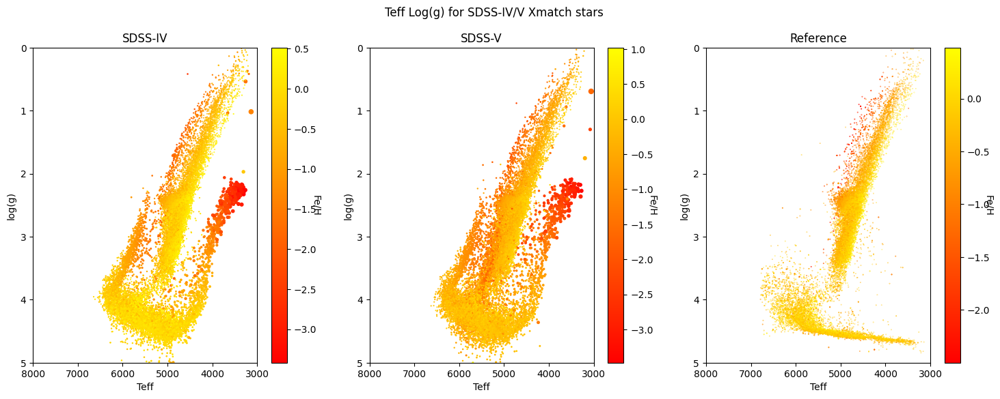

In [38]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
fig.suptitle("Teff Log(g) for SDSS-IV/V Xmatch stars")
fig.set_size_inches(18, 6)
af = a[a["teff"] > 0]

map1 = ax1.scatter(af["teff"], af["logg"], s = af["logg_err"]*2, c = af["Fe"], cmap = "autumn")
ax1.set_title("SDSS-IV")
ax1.set_xlabel("Teff")
ax1.set_ylabel("log(g)")
ax1.set_xlim([8000, 3000])
ax1.set_ylim([5, 0])

map2 = ax2.scatter(c["teff"], c["logg"], s = c["logg_err"]*2, c = c["Fe"], cmap = "autumn")
ax2.set_title("SDSS-V")
ax2.set_xlabel("Teff")
ax2.set_ylabel("log(g)")
ax2.set_xlim([8000, 3000])
ax2.set_ylim([5, 0])

map3 = ax3.scatter(r["teff"], r["logg"], s = r["logg_err"]*2, c = r["Fe"], cmap = "autumn")
ax3.set_title("Reference")
ax3.set_xlabel("Teff")
ax3.set_ylabel("log(g)")
ax3.set_xlim([8000, 3000])
ax3.set_ylim([5, 0])

fig.colorbar(map1).set_label("Fe/H", rotation=270)
fig.colorbar(map2).set_label("Fe/H", rotation=270)
fig.colorbar(map3).set_label("Fe/H", rotation=270)
fig.show()

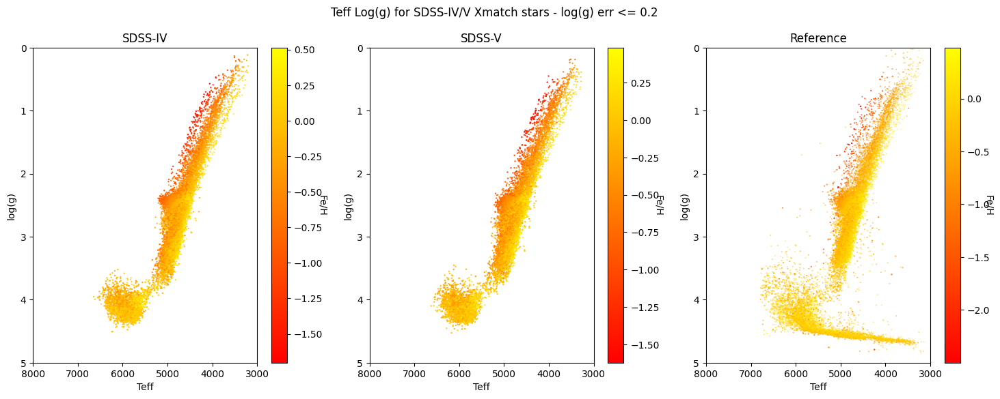

In [39]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
fig.suptitle("Teff Log(g) for SDSS-IV/V Xmatch stars - log(g) err <= 0.2")
fig.set_size_inches(18, 6)

map1 = ax1.scatter(afilt["teff"], afilt["logg"], s = afilt["logg_err"]*2, c = afilt["Fe"], cmap = "autumn")
ax1.set_title("SDSS-IV")
ax1.set_xlabel("Teff")
ax1.set_ylabel("log(g)")
ax1.set_xlim([8000, 3000])
ax1.set_ylim([5, 0])

map2 = ax2.scatter(cfilt["teff"], cfilt["logg"], s = cfilt["logg_err"]*2, c = cfilt["Fe"], cmap = "autumn")
ax2.set_title("SDSS-V")
ax2.set_xlabel("Teff")
ax2.set_ylabel("log(g)")
ax2.set_xlim([8000, 3000])
ax2.set_ylim([5, 0])

map3 = ax3.scatter(rfilt["teff"], rfilt["logg"], s = rfilt["logg_err"]*2, c = rfilt["Fe"], cmap = "autumn")
ax3.set_title("Reference")
ax3.set_xlabel("Teff")
ax3.set_ylabel("log(g)")
ax3.set_xlim([8000, 3000])
ax3.set_ylim([5, 0])

fig.colorbar(map1).set_label("Fe/H", rotation=270)
fig.colorbar(map2).set_label("Fe/H", rotation=270)
fig.colorbar(map3).set_label("Fe/H", rotation=270)
fig.show()

# Mg/Fe

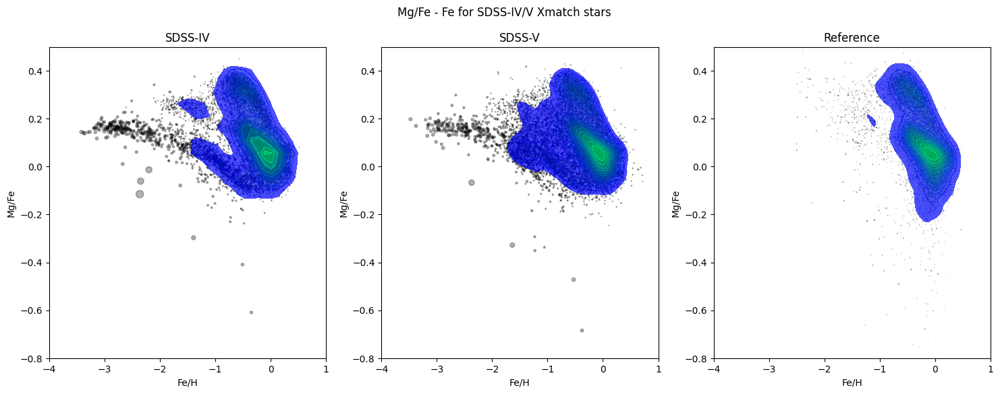

In [40]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
fig.suptitle("Mg/Fe - Fe for SDSS-IV/V Xmatch stars")
fig.set_size_inches(18, 6)

x1, y1 = a["Fe"], a["Mg/Fe"]
x2, y2 = c["Fe"], c["Mg/Fe"]
x3, y3 = r["Fe"], r["Mg/Fe"]
 

ax1.scatter(x1, y1, s = a["logg_err"]*2, c = "black", alpha = 0.3)
sns.kdeplot(x=x1, y=y1, cmap="winter", levels = 15, fill=True, alpha = 0.7, ax = ax1)
ax1.set_title("SDSS-IV")
ax1.set_xlabel("Fe/H")
ax1.set_ylabel("Mg/Fe")
ax1.set_xlim([-4, 1])
ax1.set_ylim([-0.8, 0.5])


ax2.scatter(x2, y2, s = c["logg_err"]*2, c = "black", alpha = 0.3)
sns.kdeplot(x=x2, y=y2, cmap="winter", levels = 15, fill=True, alpha = 0.7, ax = ax2)
ax2.set_title("SDSS-V")
ax2.set_xlabel("Fe/H")
ax2.set_ylabel("Mg/Fe")
ax2.set_xlim([-4, 1])
ax2.set_ylim([-0.8, 0.5])

ax3.scatter(x3, y3, s = r["logg_err"]*2, c = "black", alpha = 0.3)
sns.kdeplot(x=x3, y=y3, cmap="winter", levels = 15, fill=True, alpha = 0.7, ax = ax3)
ax3.set_title("Reference")
ax3.set_xlabel("Fe/H")
ax3.set_ylabel("Mg/Fe")
ax3.set_xlim([-4, 1])
ax3.set_ylim([-0.8, 0.5])

fig.show()

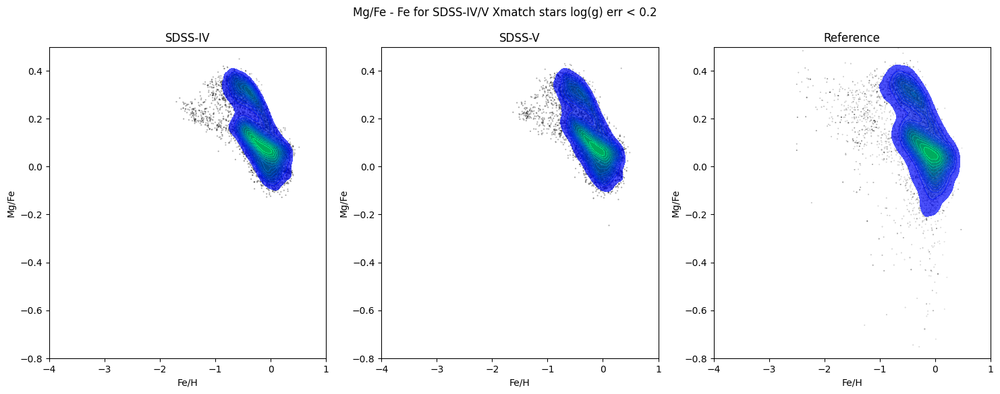

In [41]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
fig.suptitle("Mg/Fe - Fe for SDSS-IV/V Xmatch stars log(g) err < 0.2")
fig.set_size_inches(18, 6)

x1, y1 = afilt["Fe"], afilt["Mg/Fe"]
x2, y2 = cfilt["Fe"], cfilt["Mg/Fe"]
x3, y3 = rfilt["Fe"], rfilt["Mg/Fe"]
 

ax1.scatter(x1, y1, s = afilt["logg_err"]*2, c = "black", alpha = 0.3)
sns.kdeplot(x=x1, y=y1, cmap="winter", levels = 15, fill=True, alpha = 0.7, ax = ax1)
ax1.set_title("SDSS-IV")
ax1.set_xlabel("Fe/H")
ax1.set_ylabel("Mg/Fe")
ax1.set_xlim([-4, 1])
ax1.set_ylim([-0.8, 0.5])


ax2.scatter(x2, y2, s = cfilt["logg_err"]*2, c = "black", alpha = 0.3)
sns.kdeplot(x=x2, y=y2, cmap="winter", levels = 15, fill=True, alpha = 0.7, ax = ax2)
ax2.set_title("SDSS-V")
ax2.set_xlabel("Fe/H")
ax2.set_ylabel("Mg/Fe")
ax2.set_xlim([-4, 1])
ax2.set_ylim([-0.8, 0.5])

ax3.scatter(x3, y3, s = rfilt["logg_err"]*2, c = "black", alpha = 0.3)
sns.kdeplot(x=x3, y=y3, cmap="winter", levels = 15, fill=True, alpha = 0.7, ax = ax3)
ax3.set_title("Reference")
ax3.set_xlabel("Fe/H")
ax3.set_ylabel("Mg/Fe")
ax3.set_xlim([-4, 1])
ax3.set_ylim([-0.8, 0.5])

fig.show()

# NaNs in spectra

In [4]:
nans = pd.read_csv(os.path.join(geir_path, "serialized", "nans.csv"))

In [5]:
nans

,SDSSIV nans,SDSSV nans
0,2,3181
1,0,3484
2,51,3693
3,51,3693
4,65,5385
...,...,...
26709,138,447
26710,350,1501
26711,46,212
26712,25,233


<Axes: ylabel='Frequency'>

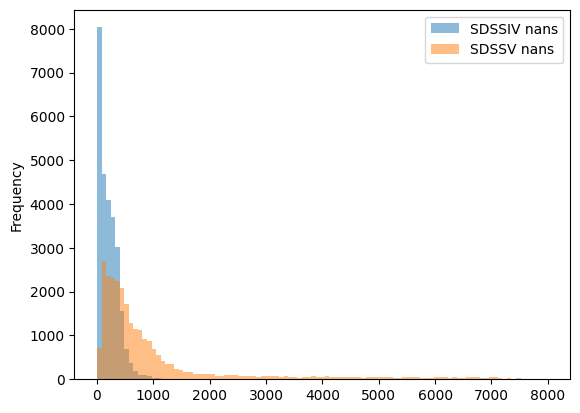

In [8]:
nans.plot(kind = "hist", bins = np.linspace(0, 8000, 100), alpha = 0.5)